# Factors Influencing Used Car Valuation
This is  Berkely Hass Module 11 assignment for Used car sales data analysis using CRISP-DM.

In [192]:
import numpy as np
import pandas as pd

from sklearn.pipeline import Pipeline
from sklearn.model_selection import GridSearchCV, train_test_split
from sklearn.linear_model import LinearRegression, Ridge, Lasso, RidgeCV, LassoCV
from sklearn.preprocessing import StandardScaler, PolynomialFeatures, OneHotEncoder
from sklearn.compose import make_column_transformer, TransformedTargetRegressor, ColumnTransformer
from sklearn.inspection import permutation_importance
from sklearn.feature_selection import SequentialFeatureSelector, SelectKBest, f_regression
from sklearn.metrics import mean_squared_error, mean_absolute_error, mean_absolute_percentage_error, r2_score

import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go


## Functions
Created functions for the repeatitive tasks and routines for data analysis, preprocessing and transformation.

In [193]:
# Custom  utility class for data exploring and analysis 
class ExploraData:
    import pandas as pd
    import re
      
    def __init__(self, df, path=None):
        self._df = df
        self._path = path

    @property
    def df(self):
        return self._df

    @df.setter
    def df(self, new_df):
        self._df = new_df   
    
    def reload(self):
        if self._path:
            self._df = pd.read_csv(self._path)
        else:
            raise ValueError("No path specified for reloading.")
        
        return self._df
        
    def column_null_stats(self, subset=None, null_only=True) -> pd.DataFrame:
        """" Calculate the null counts and percentage of total per column"""
        if subset:
            null_counts = self._df[subset].isna().sum()
        else:
            null_counts = self._df.isna().sum()

        # Calculate the percentage of null values per column
        total_rows = self._df.shape[0]
        null_percentages = (null_counts / total_rows) * 100

        # Get data types of columns in the DataFrame
        column_dtype = self._df.dtypes

        # Create a new DataFrame to display null counts, column data types, and percentage of total rows
        null_info = pd.DataFrame({
            'null count': null_counts,
            'pct_total': round(null_percentages, 2),
            'dtype': column_dtype  
        })
        if null_only:
            # Return stats of columns with missing values
            null_info = null_info.query("pct_total > 0").sort_values('pct_total', ascending=False)
        else:
            # Return stats of entire subset
            null_info = null_info.sort_values('pct_total', ascending=False)
        
        return null_info

    
    def row_null_stats(self, subset=None) -> pd.DataFrame:
        # Count the number of null values in each row
        total_rows = self._df.shape[0]
        if subset:
            self._df['_num_nulls'] = self._df[subset].isnull().sum(axis=1)
        else:
            self._df['_num_nulls'] = self._df.isnull().sum(axis=1)
        row_null_counts = self._df.groupby('_num_nulls')['_num_nulls'].count().sort_index(ascending=False)
        cumulative_sum = np.cumsum(row_null_counts)
        cumulative_pct = cumulative_sum / total_rows * 100

        row_null_stats = pd.DataFrame({
        'num_null': row_null_counts.index,     
        'count': row_null_counts,
        'pct_total': round(row_null_counts / total_rows * 100, 4),
        'cum_pct': round(cumulative_pct, 4)     
        })
        
        row_null_stats.set_index('num_null', inplace=True)
        self._df.drop(columns=['_num_nulls'], inplace=True)
        return row_null_stats
    
    def categorical_features(self, null_only=False) -> list:
        # Extract columns with 'object' dtype (assumed categorical)
        categorical_columns = set(self._df.select_dtypes(exclude=['number']).columns.tolist())
        
        if null_only:
            # Obtain the columns with null statistics (assuming column_null_stats returns a DataFrame)
            null_stats_columns = set(self.column_null_stats.index.tolist())
            categorical_columns = list(categorical_columns.intersection(null_stats_columns))

        return list(categorical_columns)
    
    def categorical_value_counts(self, normalize=True, rounding=2):
        categrical_columns = self.categorical_features()
        for col in categrical_columns:
            value_counts = self._df[col].value_counts()
            if normalize:
                value_counts = value_counts / self._df.shape[0] * 100
                value_counts = value_counts.round(rounding).astype(str) + '%'                
            print(value_counts, '\n')
            
    def numeric_features(self) -> list:
            numeric_cols = self._df.select_dtypes(include=['number']).columns.tolist()
            return numeric_cols
        
    def fillna(self, value=None):
        """Fill NaN with the value in all categorical features.
        If no `value` is given, fill with 'UNKNOWN_'
        """
        if value is None:
            value = 'UNKNOWN_'
        # Get the list of categorical columns with missing values 
        categorical_columns = self.categorical_features(null_only=True)
        # Fill missing values in the specified categorical columns with variable`value`
        self._df.loc[:, categorical_columns] = self._df[categorical_columns].fillna(value)

    def replace_all(self, to_replace, value):
        """ Search the term, to_replace, and replace it with the value in all string-like columns of a dataframe."""
        matching_cols = [
            col for col in self._df.columns
            if (self._df[col].dtype == 'object' or pd.api.types.is_string_dtype(self._df[col]))
            and to_replace in col
        ]

        if matching_cols:
            self._df.loc[:, matching_cols] = self._df.loc[:, matching_cols].replace(to_replace, value)

        return matching_cols

    def drop_marginal_row(self, pct_threshold=1, exclude=None) -> pd.DataFrame:
        column_stats = self.column_null_stats()
        columns_under_threshold = column_stats[column_stats['pct_total'] <= pct_threshold].index.tolist()
        if exclude:
            columns_to_drop = [col for col in columns_under_threshold if col not in exclude]
        else:
            columns_to_drop = columns_under_threshold
        self._df.dropna(subset=columns_to_drop, inplace=True)
        return self._df
    
        # Sort null_info by 'pct_total' in ascending order
        null_info = null_info.sort_values('pct_total')

        return null_info.query("pct_total > 0")

    def one_standing_encode(self, column, keep, name=None, drop=False):
        """ A variant of One-hot encoding. 
        Set the value in the new column to 1 if it is equal to the specified keep value.
        Set to 0, otherwise. name is the one-standing column name. If drop=True, the original column will be dropped.
        """
        if not name: # Use default name 
            rename_to = 'is_' + keep + '_' + column
        self._df[name] = (self._df[column] == keep).astype(int)
        
        if drop: # Drop the original column
            self._df.drop(columns=column, inplace=True)
        
    def regex_to_numeric(self, columns, fillna=None, regex=None):
        """ 
        Extract and set the numbers from the column values using regular expressions.
        If no regex is given, the default is to find the first occurrence of digits.
        """
        # If a single column name is provided, convert it to a list
        if not isinstance(columns, list):
            columns = [columns]
        
        for col in columns:
            # Check if the column has string values before using .str accessor
            if self._df[col].dtype in ['object', 'str', 'string', 'category']:
                # If no regex is given, find the first occurrence of digits
                if not regex: 
                    regex = r'(\d+)'
                self._df[col] = self._df[col].astype(str).str.extract(regex).astype(float)
                if fillna:
                    if fillna == 'mean':
                        self._df[col].fillna(self._df[col].mean)
                    else:
                        raise ValueError("Only fillna with 'mean' is supported.")

        
    def fillna_with_mean(self, exclude=None):
        # If exclude is not specified, fill NaN with mean for all numeric columns
        if exclude is None:
            numeric_columns = self._df.select_dtypes(include=[np.number]).columns
            columns_to_fill = [
                col for col in numeric_columns if not self._df[col].apply(lambda x: isinstance(x, str)).any()
            ]
            self._df[columns_to_fill] = self._df[columns_to_fill].fillna(self._df.mean())
        else:
            # Fill NaN with mean for numeric columns except those specified in 'exclude'
            columns_to_fill = [
                col for col in self._df.columns if col not in exclude and np.issubdtype(self._df[col].dtype, np.number)
            ]
            fill_values = self._df[columns_to_fill].mean()
            self._df[columns_to_fill] = self._df[columns_to_fill].fillna(fill_values)

    def target_binning(self, feature, target, n_bins, fillna=None):
        """ A variant of Target Encoding. 
        Binning the categorical values, into n_bins bins, based on
        the min and max means of the target of each categorical group.
        The group with the min(means) is set to the min(means) value.
        The group with the max(means) is set to the max(means) value.
        The range between min(means) and max(means) is equally cut into (n_bins - 1) intervals.
        """
        # Pre-fill missing values in the feature if specified
        if fillna:
            self._df[feature].fillna(fillna, inplace=True)
        else:
            # missing values are not filled and their ratings will be NaN
            pass
                       
        # Calculate the mean target values of individual feature values
        means = self._df.groupby(feature)[target].mean()
        # Get min, max to determine the range to be divided by n_bins
        min_, mean_, max_ = means.min(), means.mean(), means.max()
        # Divide the (min, max) range equally
        step = (max_ - min_) / (n_bins - 1)

        # Create bins based on means. the first bin label is _min, then steps up until, _max
        labels = [(min_ + i * step) for i in range(n_bins)]
        ratings = pd.cut(means, bins=n_bins, labels=labels, right=True, include_lowest=True).to_frame()

        ratings.reset_index(inplace=True)
        encoded_column_name = feature + '_rating'
        ratings.rename(columns={target: (encoded_column_name)}, inplace=True)

        # Create a new column and initialize it with NaN values
        self._df[encoded_column_name] = np.nan

        # Assign ratings based on feature values
        for index, row in ratings.iterrows():
            rating = row[encoded_column_name]
            feature_value = row[feature]
            self._df.loc[self._df[feature] == feature_value, encoded_column_name] = rating     
        
        # Convert the encoded column to int if no missing values
        if self._df[encoded_column_name].isna().sum() == 0: 
            self._df[encoded_column_name] = self._df[encoded_column_name].astype(int)   
            
        # Construct a mapping of ratings to lists of feature values
        rating_mapping = {}
        for index, row in ratings.iterrows():
            rating = row[encoded_column_name]
            feature_value = row[feature]
            if rating not in rating_mapping:
                rating_mapping[rating] = [feature_value]
            else:
                rating_mapping[rating].append(feature_value)
        sorted_keys = sorted(rating_mapping.keys(), reverse=True)  # Sort the keys
        sorted_rating_mapping = {key: rating_mapping[key] for key in sorted_keys}
        return sorted_rating_mapping
            
    def b4_aft(self, command, rounding=2):
        """Execute the command and print out the stats of affected rows.
        Use literal values in the command if the command takes arguments. 
        Variables are not evaludated and cannot be used as arguments.
        """
        shape_before = self._df.shape
        results = exec(command)
        shape_after = self._df.shape
        row_diff =  shape_before[0] - shape_after[0] 
        col_diff =  shape_before[1] - shape_after[1]
        if shape_before != shape_after:
            print(f'Dataset shape changed: {shape_before} -> {shape_after}')
            if row_diff > 0:
                print(f'{row_diff:,} of {shape_before[0]:,} rows, {round(100 * row_diff/shape_before[0], rounding)}%, dropped.')    
        return results

    def before_after_exec(self, command, dataframe=None, rounding=2):
        """Execute the command and print out the stats of affected dataframe.
        Literal referrence to 'df' is treated as calling by reference and the external df dataframe will be updated.
        """
        exec_globals = {dataframe: self._df}
        shape_before = self._df.shape
        results = exec(command, exec_globals)
        shape_after = self._df.shape
        row_diff =  shape_before[0] - shape_after[0] 
        col_diff =  shape_before[1] - shape_after[1]
        if shape_before != shape_after:
            print(f'Dataset shape changed: {shape_before} -> {shape_after}')
            if row_diff > 0:
                print(f'{row_diff:,} of {shape_before[0]:,} rows, {round(100 * row_diff/shape_before[0], rounding)}%, dropped.')    
        # Check if the dataframe variable has been assigned in the executed command
        if dataframe in exec_globals:
            self._df = exec_globals[dataframe]
            # Update the external dataframe
            globals()[dataframe] = self._df
        return results
    
    def performance_metrics(self, y, y_hat, n_features=None):
        """ Returns R2, Adj. R2, MSE, RMSE, MAE, MAPE scores as a dict. AdR2 Adj is returned on if n_features is provided.
            y are the actual target values, y_hat are the predicted values
        """
        metrics = {}
        metrics['R2'] = r2_score(y, y_hat)        
        if isinstance(n_features, int): # Calculate Adj. R-squared
            n = len(y)
            k = n_features # Number of predictors
            metrics['Adj. R2'] = 1 - (1 - metrics['R2']) * (n - 1) / (n - k - 1)
        
        metrics['MSE'] = mean_squared_error(y, y_hat)
        metrics['RMSE'] = np.sqrt(mean_squared_error(y, y_hat))
        metrics['MAE'] = mean_absolute_error(y, y_hat)
        metrics['MAPE'] = mean_absolute_percentage_error(y, y_hat)
        
        return metrics

##  Data reading and loading

In [194]:
df = pd.read_csv('data/vehicles.csv', sep = ',')
print(f'Dataset dimensions as loaded: {df.shape}')
# df.drop_duplicates(inplace=True)
print(f'Datase dimensions after dropping duplicates: {df.shape}')
# Use a custom Data Exploration Analysis utilties
ed = ExploraData(df, 'data/vehicles.csv')

Dataset dimensions as loaded: (426880, 18)
Datase dimensions after dropping duplicates: (426880, 18)


## Data Discovery

In [195]:
df.head()


,id,region,price,year,manufacturer,model,condition,cylinders,fuel,odometer,title_status,transmission,VIN,drive,size,type,paint_color,state
0,7222695916,prescott,6000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,az
1,7218891961,fayetteville,11900,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,ar
2,7221797935,florida keys,21000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,fl
3,7222270760,worcester / central MA,1500,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,ma
4,7210384030,greensboro,4900,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,nc


In [196]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 426880 entries, 0 to 426879
Data columns (total 18 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   id            426880 non-null  int64  
 1   region        426880 non-null  object 
 2   price         426880 non-null  int64  
 3   year          425675 non-null  float64
 4   manufacturer  409234 non-null  object 
 5   model         421603 non-null  object 
 6   condition     252776 non-null  object 
 7   cylinders     249202 non-null  object 
 8   fuel          423867 non-null  object 
 9   odometer      422480 non-null  float64
 10  title_status  418638 non-null  object 
 11  transmission  424324 non-null  object 
 12  VIN           265838 non-null  object 
 13  drive         296313 non-null  object 
 14  size          120519 non-null  object 
 15  type          334022 non-null  object 
 16  paint_color   296677 non-null  object 
 17  state         426880 non-null  object 
dtypes: f

In [197]:
# Columns with missing  or null values

ed.column_null_stats()

,null count,pct_total,dtype
size,306361,71.77,object
cylinders,177678,41.62,object
condition,174104,40.79,object
VIN,161042,37.73,object
drive,130567,30.59,object
paint_color,130203,30.50,object
type,92858,21.75,object
manufacturer,17646,4.13,object
title_status,8242,1.93,object
model,5277,1.24,object


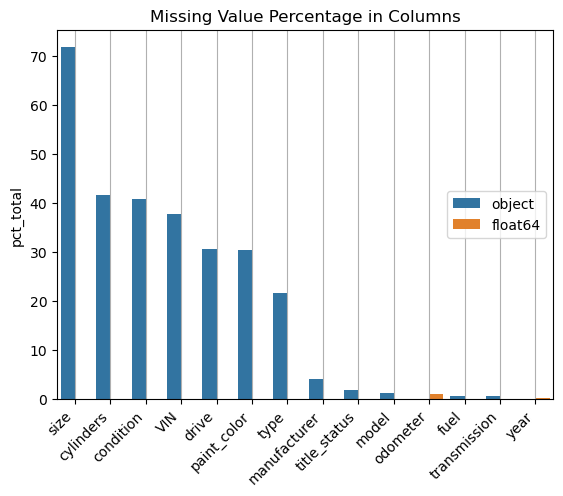

In [198]:
null_cols = ed.column_null_stats()
# Plot params
sns.barplot(null_cols, y='pct_total', x=null_cols.index, hue='dtype')
plt.legend(loc='center right')
plt.title("Missing Value Percentage in Columns")
plt.grid(axis='x')
plt.xticks(rotation=45, ha='right')
plt.savefig('images/pct_total_missing_val.png', bbox_inches='tight',pad_inches=0.5)
plt.show()

In [199]:
#Summary of Rows Containing Null Values, Categorized by the Count of Missing Entries"
ed.row_null_stats()

,count,pct_total,cum_pct
num_null,,,
14,68,0.0159,0.0159
11,24,0.0056,0.0216
10,539,0.1263,0.1478
9,125,0.0293,0.1771
8,4279,1.0024,1.1795
7,30443,7.1315,8.3110
6,19246,4.5085,12.8195
5,21196,4.9653,17.7849
4,46728,10.9464,28.7313


## Overview of Incomplete Data in Rows

1.Less than 9% of the dataset contains rows with no missing information across all 18 columns.

2.Approximately half of the dataset's rows exhibit more than 3 missing values."

In [200]:
print(f'Numeric features:\n{ed.numeric_features()}\n')
print(f'Categorical features:\n{ed.categorical_features()}')

Numeric features:
['id', 'price', 'year', 'odometer']

Categorical features:
['transmission', 'title_status', 'cylinders', 'manufacturer', 'paint_color', 'fuel', 'size', 'condition', 'region', 'type', 'model', 'VIN', 'state', 'drive']


In [201]:
ed.categorical_value_counts(rounding=4)

automatic    78.8334%
other        14.6838%
manual        5.8841%
Name: transmission, dtype: object 

clean         94.9018%
rebuilt        1.6911%
salvage        0.9061%
lien           0.3331%
missing        0.1907%
parts only     0.0464%
Name: title_status, dtype: object 

6 cylinders     22.0598%
4 cylinders     18.1882%
8 cylinders     16.8811%
5 cylinders       0.401%
10 cylinders     0.3408%
other            0.3041%
3 cylinders      0.1534%
12 cylinders      0.049%
Name: cylinders, dtype: object 

ford               16.6288%
chevrolet          12.8992%
toyota              8.0121%
honda               4.9824%
nissan              4.4666%
jeep                4.4542%
ram                 4.2968%
gmc                  3.932%
bmw                 3.4434%
dodge                3.211%
mercedes-benz       2.7682%
hyundai             2.4218%
subaru              2.2243%
volkswagen          2.1891%
kia                 1.9811%
lexus               1.9209%
audi                 1.774%
cadillac       


## Data Analysis of Categorical Attributes



1.The 'cylinders' attribute is suitable for conversion into a numerical format."


2.The 'VIN' column lacks uniqueness, with the specific VIN '1FMJU1JT1HEA52352' recurring 261 times.



## Data Preparation , Preprocessing andTransformation Steps

In [202]:
# Columns containing 'other' as value. 
subset = ['fuel', 'cylinders', 'type', 'transmission']
# Strip whitespace
df.loc[:, subset] = df.loc[:, subset].apply(lambda x: x.str.strip() if x.dtype == 'object' else x)
# Repalce 'other' with NaN
df.loc[:, subset] = df.loc[:, subset].replace('other', np.nan)

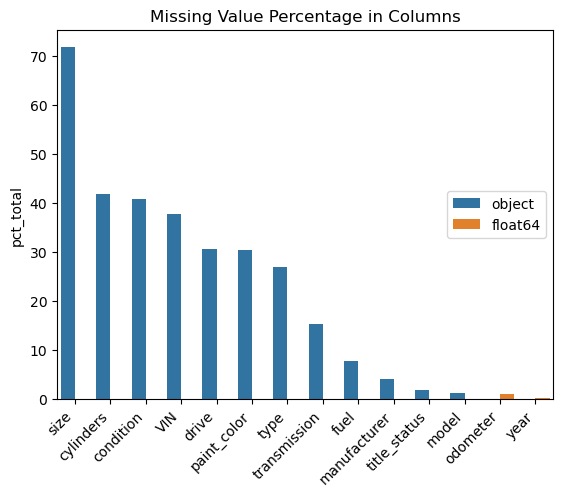

,null count,pct_total,dtype
size,306361,71.77,object
cylinders,178976,41.93,object
condition,174104,40.79,object
VIN,161042,37.73,object
drive,130567,30.59,object
paint_color,130203,30.50,object
type,114968,26.93,object
transmission,65238,15.28,object
fuel,33741,7.90,object
manufacturer,17646,4.13,object


In [203]:
# Columns with missing values
data = ed.column_null_stats()
# Plot params
sns.barplot(data, y='pct_total', x=data.index, hue='dtype')
plt.legend(loc='center right')
plt.title("Missing Value Percentage in Columns")
plt.xticks(rotation=45, ha='right')
plt.show()
data

### Elimination of Rows Lacking Data in Key Columns:
The specified columns have missing values ranging from 0.28% to 7.9%:

* `year`
* `odometer`
* `cylinders`
* `fuel`
* `title_status`
* `model`
* `manmufacturer`

Combined, they represent 15.05% of total rows. Dropped.

In [204]:
# Remove Rows from Columns Where Less Than 5% of Total Rows Contain Missing Values
ed.b4_aft("ed.drop_marginal_row(pct_threshold=8)")

Dataset shape changed: (426880, 18) -> (362614, 18)
64,266 of 426,880 rows, 15.05%, dropped.


In [205]:
df.VIN.value_counts()

1FMJU1JT1HEA52352    261
3C6JR6DT3KG560649    235
1FTER1EH1LLA36301    231
1GCHTCE37G1186784    214
1GTN1TEH5EZ273019    207
                    ... 
2FMDK3J96DBA97263      1
1GCVKPEC9JZ183102      1
KL7CJPSB1JB671407      1
3G1BE6SM6HS502859      1
SAJGX2749VCOO8376      1
Name: VIN, Length: 101682, dtype: int64


### Handling Duplicates in the VIN Column


* A significant number of duplicate VINs are noted.

* Eliminated duplicate records, retaining only the first instance, when they have identical VIN, model, year, odometer, and price.

* Any rows with duplicated VINs that do not match the aforementioned criteria are also removed.

* This results in the removal of 40% of the total records from the orginal records

In [206]:
# Drop rows with duplicates based on 'VIN', 'odometer', and 'price' columns keeping the first occurrence
ed.b4_aft("df.drop_duplicates(subset=['VIN', 'model', 'year', 'odometer', 'price', 'type'], keep='first', inplace=True)")

Dataset shape changed: (362614, 18) -> (216231, 18)
146,383 of 362,614 rows, 40.37%, dropped.


In [207]:
df.VIN.value_counts()

2D4GV77387S671809    10
NM0GS9F23K1426362    10
1.07044E+13           8
3C6UR5CLXJG328900     8
1FT8W4DT4KEE14983     8
                     ..
SALYB2RX0JA706186     1
1FDFE4FS0HDC33579     1
KM8JM12B29U977977     1
KMHTC6AD6HU305124     1
SAJGX2749VCOO8376     1
Name: VIN, Length: 101682, dtype: int64

### Drop non-null duplicate VINs


In [208]:
command = "df = df[~((df['VIN'].notna()) & (df['VIN'].duplicated()))]"
ed.before_after_exec(command, dataframe='df')

In [209]:
# Drop the 'VIN' column
df.drop(columns=['VIN'], inplace=True)

### Drop low-value Columns
* Unique IDs: 
    - `id`: unique value of data observation
* Low Density
    - `size`: 71.77% of records have missing values.
* Reserved for future analysis
    - `region`, `state`, `paint_color`

In [210]:
try:
    ed.b4_aft("df.drop(columns=['id', 'size', 'region', 'state', 'paint_color'], inplace=True)")
except:
    pass

Dataset shape changed: (210317, 17) -> (210317, 12)


### The  `cylinders` column
* Use regular expressioin to extract the number from textual values
* Drop rows where the value is unknown

####   Isolating Numerical Data from Text in the 'cylinders' Column

In [211]:
print('Unique value counts:')
print(df['cylinders'].value_counts(),'\n')

# Replace with extracted numbers from the textual values.
# Default Regular Expression finds the 1st instance of digits
ed.regex_to_numeric(columns='cylinders')

# Values that were missing or not transformed
na_count = df.cylinders.isna().sum()
print(f'Count of NaN: {na_count:,}, {na_count/df.shape[0] * 100:.2f}%\n')
print('Transformed Values:')
print(df['cylinders'].value_counts())

Unique value counts:
4 cylinders     50776
6 cylinders     49837
8 cylinders     35966
5 cylinders      1183
10 cylinders      629
3 cylinders       328
12 cylinders       86
Name: cylinders, dtype: int64 

Count of NaN: 71,512, 34.00%

Transformed Values:
4.0     50776
6.0     49837
8.0     35966
5.0      1183
10.0      629
3.0       328
12.0       86
Name: cylinders, dtype: int64


#### Elimination of Rows Lacking Data in the 'cylinders' Column
* Given the correlation of a higher number of cylinders with increased horsepower and price.
* To prevent distortion in the analysis due to missing values.
* This leads to the removal of over 71,000 records, constituting 34% of the dataset

In [212]:
 # Drop missing value in `cylinders` column
ed.b4_aft("df.dropna(subset='cylinders', inplace=True)")

Dataset shape changed: (210317, 12) -> (138805, 12)
71,512 of 210,317 rows, 34.0%, dropped.


In [213]:
ed.column_null_stats()

,null count,pct_total,dtype
condition,33165,23.89,object
type,20759,14.96,object
drive,14355,10.34,object
transmission,3892,2.80,object


### The `year` and  the new `age` columns Analysis of 'year' and Newly Created 'age' Columns:
* The source and details of the dataset is no longer traceable.Due to untraceable source and details of the dataset. 
* Assumming all sales transations occurred in 2022 when determining the ages of vehicles. For example, a 2022 model car sold in 2022 had the `age`=0 Assuming all sales transactions took place in 2022 for the purpose of calculating vehicle ages. Consequently, a 2022 model car sold in 2022 is assigned an 'age' of

In [214]:
# Create the new 'age' column and drop the 'year' column
df['age'] = (2023 - df['year'])
df['age'] = df['age'].astype(int)
df.drop(columns='year', inplace=True)

In [215]:
# Plot the distribution of 'age'
px.histogram(df, x='age', marginal='box', title="Skewed Distribution of Car Age")

In [216]:
 # Plot params
df.info()
plot_data = df.sample(30000).query('price < 2_000_000')
px.scatter(plot_data, x='age', y='price', title='Age vs. Price')

<class 'pandas.core.frame.DataFrame'>
Int64Index: 138805 entries, 27 to 426833
Data columns (total 12 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   price         138805 non-null  int64  
 1   manufacturer  138805 non-null  object 
 2   model         138805 non-null  object 
 3   condition     105640 non-null  object 
 4   cylinders     138805 non-null  float64
 5   fuel          138805 non-null  object 
 6   odometer      138805 non-null  float64
 7   title_status  138805 non-null  object 
 8   transmission  134913 non-null  object 
 9   drive         124450 non-null  object 
 10  type          118046 non-null  object 
 11  age           138805 non-null  int32  
dtypes: float64(2), int32(1), int64(1), object(8)
memory usage: 13.2+ MB


In [217]:
df.query('age <= 20 and price > 500000')

,price,manufacturer,model,condition,cylinders,fuel,odometer,title_status,transmission,drive,type,age
79088,655000,chrysler,town & country,good,6.0,gas,106000.0,clean,automatic,NaN,NaN,13
95119,990000,mercedes-benz,amg g 63,NaN,8.0,gas,4085.0,clean,automatic,4wd,SUV,6
105843,6995495,dodge,journey,NaN,4.0,gas,135888.0,clean,automatic,fwd,SUV,9
136516,17000000,ram,2500,good,8.0,diesel,170000.0,rebuilt,automatic,4wd,pickup,16
155421,1234567,jeep,wrangler,like new,6.0,gas,123456.0,clean,automatic,4wd,SUV,17
230753,135008900,nissan,titan se kingcab,like new,8.0,gas,110500.0,clean,automatic,4wd,truck,15
318592,3736928711,toyota,tundra,excellent,8.0,gas,164000.0,clean,automatic,4wd,pickup,16
416145,999999,ford,f-350,NaN,8.0,diesel,204123.0,clean,automatic,NaN,NaN,17


A 16 year old Toyota Tundra for 3.7 billion? A 15 year old Nissan Tundra for 135 million?

In [218]:
# Drop data anomalies
df.drop(df.query('age <= 20 and price > 500000').index, inplace=True)

* A Toyota, on average, is more expensive than a Ferrari?
* Mean prices for Porsche and Mercedes-Bens seem low. Or, others on top too high?

In [219]:
df.groupby('manufacturer').mean(numeric_only=True).sort_values('price', ascending=False)

,price,cylinders,odometer,age
manufacturer,,,,
toyota,292978.073960,5.183736,128316.062397,13.779471
ferrari,113304.852941,8.588235,18306.000000,17.794118
buick,76370.957573,5.692803,133359.344791,16.215897
ford,62809.744175,6.477282,125139.645118,15.494423
aston-martin,55879.181818,10.363636,22756.636364,13.545455
tesla,49913.666667,4.000000,24444.000000,5.666667
gmc,42208.094377,7.183986,130435.394198,13.452613
porsche,31004.221190,6.100372,95693.644981,18.223048
rover,24342.640940,6.342282,88252.775168,11.994966


In [220]:
brands = ['buick','ford','toyota','gmc','dodge','subaru', 'gmc', 'ram']
df.query("manufacturer == @brands and price > 100000 and age < 25")

,price,manufacturer,model,condition,cylinders,fuel,odometer,title_status,transmission,drive,type,age
7109,116000,ford,f350 diesels powerstroke,like new,8.0,diesel,24000.0,lien,automatic,4wd,truck,4
11905,110000,ram,1500 trx,new,8.0,gas,38.0,clean,automatic,4wd,NaN,2
29198,103500,ford,mustang gt,like new,8.0,gas,2222.0,clean,NaN,rwd,coupe,7
29386,1111111111,ford,f350 super duty lariat,good,8.0,diesel,149000.0,clean,automatic,rwd,pickup,24
46330,110000,ram,5500 laramie chassis 4x4,like new,6.0,diesel,16873.0,clean,automatic,4wd,truck,4
49237,110000,ram,5500 4x4 laramie chassis,like new,6.0,diesel,16873.0,clean,automatic,4wd,truck,4
56816,135000,ford,mustang shelby gt500,like new,8.0,gas,3463.0,clean,manual,rwd,coupe,14
85446,102999,ford,mustang,good,8.0,gas,461.0,clean,automatic,rwd,NaN,3
91502,150000,ford,escape,good,4.0,gas,182415.0,clean,automatic,fwd,SUV,14
111853,135000,dodge,challenger srt demon,like new,8.0,gas,1588.0,clean,automatic,rwd,coupe,5


In [221]:
# Drop the records above
brands = ['buick','ford','toyota','gmc','dodge','subaru']
df.drop(df.query("manufacturer == @brands and price > 150000 and age < 25").index, inplace=True)

### "One-standing" Encode Ferrari

In [222]:
# Ferrari, on average, commands a price premium of 50% over its closest competitor, justifying the creation of a distinct indicator for it.
ed.one_standing_encode(column='manufacturer', keep='ferrari', name='Ferrari', drop=False)

###  Classification of Classic, Vintage, and Antique Vehicles
* The `age`/`price` plot above shows that the prices trend down as a car ages until around 25-year old when some cars' prices start to trend up. 
* Generally speaking, classic cars are at least 20 years old but not older than 45 years, while vintage cars are 25 years or older. Antique cars are even older, at least 45 years old. 
* The box plot for `age` demarkating the outlier upper fence is 29-year old.
* To simplify model building and evaluation, the decision is to creat a binary columns, `is_vintage` to identify vintage and antique cars.

In [223]:
df['is_vintage'] = df['age'].apply(lambda x: 1 if x >=25 else 0)

### Management of Anomalies and Outliers in the 'price' Column:
####  Eliminate records where the price is less than $10, which comprises 6.85% of the total datase
* price < 10 (6.85% of total)

In [224]:
# Plot Price Distribution
px.histogram(df.query("price < 500_000"), x='price', marginal='box', 
             title="Outliers in Price")

In [225]:
# Plot Price Distribution < 5,000
px.histogram(df.query("price < 5000"), x='price', marginal='box', 
             title="Outliers in Price")

In [226]:
# Drop a row if its price < 500
ed.b4_aft("df.drop(df.query('price < 500').index, inplace=True)")

Dataset shape changed: (138790, 14) -> (129862, 14)
8,928 of 138,790 rows, 6.43%, dropped.


`price`, `odometer` anomalies, low mileage, low price, 96 rows

In [227]:
df.query("price < 600 and condition != 'salvage' and odometer < 1000").sort_values('price')

,price,manufacturer,model,condition,cylinders,fuel,odometer,title_status,transmission,drive,type,age,Ferrari,is_vintage
46651,500,ford,thunderbird turbo coupe,good,6.0,gas,0.0,parts only,automatic,NaN,coupe,36,0,1
72438,500,honda,cb750sc,fair,4.0,gas,1.0,clean,manual,NaN,NaN,41,0,1
302197,500,ford,mustang convertible,fair,8.0,gas,1.0,missing,automatic,rwd,NaN,52,0,1
378584,500,chevrolet,cobalt,good,4.0,gas,0.0,clean,automatic,NaN,NaN,15,0,0
410575,500,ford,thund,fair,8.0,gas,1.0,clean,automatic,NaN,NaN,52,0,1
144404,513,dodge,challenger,NaN,8.0,gas,10.0,clean,automatic,rwd,coupe,3,0,0
145201,514,dodge,charger,NaN,8.0,gas,10.0,clean,automatic,rwd,sedan,3,0,0
144607,531,jeep,grand cherokee,NaN,6.0,gas,30.0,clean,automatic,4wd,SUV,2,0,0
144935,539,chrysler,pacifica,NaN,6.0,gas,11.0,clean,automatic,fwd,van,2,0,0
144963,539,jeep,grand cherokee,NaN,6.0,gas,11.0,clean,automatic,4wd,SUV,2,0,0


In [228]:
result_idx = df.query("price < 600 and condition != 'salvage' and odometer < 1000").index
df.drop(result_idx, inplace=True)


Observations of Price Anomalies:


* Notable examples of pricing irregularities include a 1999 Ford F350 listed at 1,111,111,111 and
* 1999 Ford f350 priced at 1,111,111,111, a 2007 Toyota Tundra at $3,736,928,711, among several other similar instances."







In [229]:
# Non-vintage cars worth more than 0.5 million
df.query('price > 350_000 and is_vintage !=1')

,price,manufacturer,model,condition,cylinders,fuel,odometer,title_status,transmission,drive,type,age,Ferrari,is_vintage
68935,2000000,saturn,l-series l200 4dr sedan,good,4.0,gas,164290.0,clean,automatic,fwd,sedan,21,0,0


In [230]:
# Drop a row if non-vintage car, price > 500,000,000
ed.b4_aft("df.drop(df.query('price > 500_000 and is_vintage !=1').index, inplace=True)", rounding=4)

Dataset shape changed: (129850, 14) -> (129849, 14)
1 of 129,850 rows, 0.0008%, dropped.


#### (`age`, `odometer`) anomalies observed and dropped
* `ag` = 0, 1 with unreasonably high odometer readings ( > 200,000)

In [231]:
# sns.scatterplot(df.query("age < 1"), x='age', y='odometer')
ed.b4_aft("df.drop(df[(df['age'] <= 1) & (df['odometer'] > 200_000)].index, inplace=True)", rounding=4)

Dataset shape changed: (129849, 14) -> (129847, 14)
2 of 129,849 rows, 0.0015%, dropped.


In [232]:
# Plot Price Distribution < 5,000
plot_data = df.query("(age <= 1) & (odometer < 5000) & (title_status == 'clean')")
px.scatter(plot_data, y='price', x='odometer',title="Price/Odometer")

* Young `age`<=1, low `odometer`<5000 reading, low `price`<5000, and `title_status`='clean'

In [233]:
#Data Anamolies
conditions = "(age <= 2) & (price < 10000) & (odometer < 10000)"
results = df.query(conditions).sort_values('price', ascending=False)
results

,price,manufacturer,model,condition,cylinders,fuel,odometer,title_status,transmission,drive,type,age,Ferrari,is_vintage
111589,9950,toyota,corolla,NaN,4.0,gas,8466.0,clean,automatic,fwd,sedan,2,0,0
60008,7000,chevrolet,silverado,NaN,6.0,gas,6711.0,clean,automatic,NaN,NaN,2,0,0
65376,7000,chevrolet,silverado,NaN,6.0,gas,6511.0,clean,automatic,NaN,NaN,2,0,0
169767,5800,chevrolet,spark ls,good,4.0,gas,1956.0,salvage,automatic,fwd,hatchback,2,0,0
274459,1195,volkswagen,sand rail,fair,4.0,gas,100.0,clean,manual,NaN,offroad,2,0,0
193618,1089,cadillac,xt6 premium luxury,excellent,6.0,gas,0.0,clean,automatic,4wd,SUV,2,0,0
195849,1089,cadillac,xt6 premium luxury,excellent,6.0,gas,0.0,clean,automatic,4wd,SUV,2,0,0
275331,999,mercedes-benz,gle 350,new,4.0,gas,2800.0,clean,automatic,4wd,SUV,2,0,0
90595,999,bmw,m550i,like new,8.0,gas,4163.0,clean,automatic,4wd,sedan,2,0,0
323176,757,toyota,4runner sr5 premium,NaN,6.0,gas,5040.0,clean,automatic,4wd,SUV,2,0,0


In [234]:
df.drop(results.index, inplace=True)

### The `type` Column
#### Identified Irregularities in the 'type' Column
* Instances of incorrect categorization, such as sedans and trucks being erroneously labeled as buses

In [235]:
df.query("type == ['bus']")[['price','manufacturer', 'model', 'type']]

,price,manufacturer,model,type
4583,22950,ford,e-450,bus
9817,1800,gmc,yukon xl,bus
10417,23800,volkswagen,van/bus,bus
19602,6950,ford,f350 super duty,bus
21760,10000,chevrolet,school bus,bus
...,...,...,...,...
401812,22000,volkswagen,type 2 kombi,bus
402045,16500,volkswagen,vanagon,bus
404429,25000,volkswagen,camper,bus
410096,1500,chevrolet,g30 bus,bus


In [236]:
# Drop rows where 'type' is 'Bus'
ed.b4_aft("df.drop(df[df['type'] == 'bus'].index, inplace=True)")

Dataset shape changed: (129830, 14) -> (129697, 14)
133 of 129,830 rows, 0.1%, dropped.


### The `condition` column
* 'new' cars have the following unreasonable mean values:
<pre>
price	        cylinders	odometer	   age	        						
32095.571429	6.015238	54575.249524	9.998095	

In [237]:
df.query("condition == 'new'").groupby('condition').mean(numeric_only=True)

,price,cylinders,odometer,age,Ferrari,is_vintage
condition,,,,,,
new,31962.846743,6.017241,54777.191571,11.030651,0.0,0.076628


In [238]:
plot_data = df.query("is_vintage !=1")
px.scatter(plot_data, x='price', y='condition', marginal_x='box', marginal_y='histogram')

#### Price anomalies observed in 'salvage' `condition` cars.
* Over 35k in price

In [239]:
df.query("condition == 'salvage'").sort_values('price', ascending=False)

,price,manufacturer,model,condition,cylinders,fuel,odometer,title_status,transmission,drive,type,age,Ferrari,is_vintage
243401,35989,gmc,sierra 2500 hd,salvage,8.0,gas,85233.0,salvage,automatic,fwd,truck,6,0,0
150487,26997,ford,transit,salvage,6.0,gas,22000.0,salvage,automatic,rwd,NaN,3,0,0
184019,23985,chevrolet,silverado 3500,salvage,8.0,diesel,53664.0,salvage,automatic,4wd,pickup,4,0,0
100093,22000,chevrolet,silverado 1500,salvage,8.0,gas,94141.0,rebuilt,automatic,rwd,truck,9,0,0
215502,21990,chrysler,pacifica limited,salvage,6.0,gas,11576.0,rebuilt,automatic,fwd,van,6,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
92028,500,jeep,cherokee,salvage,6.0,gas,130000.0,clean,automatic,rwd,SUV,23,0,0
178089,500,honda,accord,salvage,6.0,gas,165000.0,clean,automatic,fwd,coupe,19,0,0
96485,500,cadillac,deville,salvage,8.0,gas,150000.0,parts only,automatic,NaN,sedan,23,0,0
285562,500,ford,focus,salvage,4.0,gas,180000.0,clean,manual,fwd,NaN,20,0,0


In [240]:
# Drop 'new' and 'salvage' and 'parts only' values in `condition`
df.drop(df[(df['condition'] == 'salvage') | (df['condition'] == 'parts only')].index, inplace=True)
# Drop 'new' and 'salvage' and 'parts only' values in `condition`
df.drop(df[(df['title_status'] == 'salvage') | (df['title_status'] == 'parts only')].index, inplace=True)

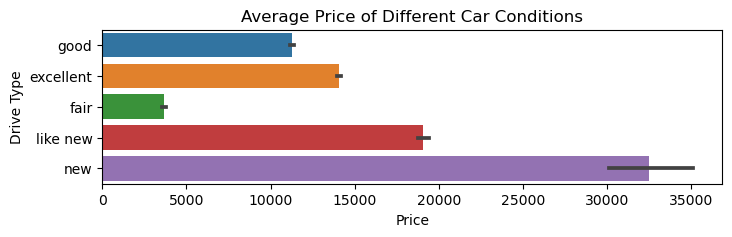

,price,cylinders,odometer,age,Ferrari,is_vintage
condition,,,,,,
fair,3672.095820,5.999678,190091.414148,18.198714,0.000000,0.0
good,11297.859979,5.877546,138529.216467,13.953187,0.000064,0.0
excellent,14069.593590,5.675179,113139.049128,12.174274,0.000206,0.0
like new,19079.248800,5.660921,84590.931136,10.162431,0.000267,0.0
new,32509.919149,5.925532,53913.080851,7.468085,0.000000,0.0


In [241]:
# plot the average price of different feature values
plot_data = df.query("is_vintage !=1")
feature = 'condition'
plt.figure(figsize=(8, 2))
sns.barplot(x='price', y=feature, data=plot_data, estimator=lambda x: sum(x) / len(x))
plt.title('Average Price of Different Car Conditions')
plt.xlabel('Price')
plt.ylabel('Drive Type')
plt.savefig(f'images/price_by_{feature}.png', bbox_inches='tight')
plt.show()

plot_data.groupby(feature).mean(numeric_only=True).sort_values('price')

In [242]:
# Anomalies where `new` cars' mean `age` is 6.5
df.query("condition == 'new' and age >= 1 and odometer > 1000")

,price,manufacturer,model,condition,cylinders,fuel,odometer,title_status,transmission,drive,type,age,Ferrari,is_vintage
186,21250,ford,thunderbird,new,8.0,gas,15996.0,clean,automatic,fwd,convertible,21,0,0
1801,21500,toyota,hilux,new,4.0,diesel,72000.0,clean,manual,4wd,truck,33,0,1
1824,49900,lexus,rx 450h,new,6.0,hybrid,1900.0,clean,automatic,4wd,SUV,4,0,0
4732,43500,ford,f150 xlt,new,8.0,gas,13500.0,lien,automatic,rwd,pickup,3,0,0
5015,73000,ford,f350 lariat,new,8.0,diesel,8000.0,lien,automatic,NaN,NaN,3,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
423026,2900,ford,explorer,new,8.0,gas,170000.0,clean,automatic,4wd,NaN,17,0,0
423141,15000,chevrolet,camero,new,6.0,gas,30000.0,clean,automatic,NaN,coupe,22,0,0
423522,6995,ford,fusion sport awd,new,6.0,gas,93000.0,clean,automatic,4wd,sedan,13,0,0
423846,7000,lincoln,mkz,new,6.0,gas,113000.0,clean,automatic,4wd,sedan,13,0,0


In [243]:
# Consider these are not 'new'. Drop these data anomalies
df.drop(df.query("condition == 'new' and age >= 1 and odometer > 1000").index, inplace=True)

In [244]:
# Drop the `condition` column * As shown above, the average age for 'new' cars is 6.5 years old and they
#have high odometer readings.The quality of the values in the `condition` column cannot be trusted.

df.drop(columns='condition', inplace=True)

### The `drive` column

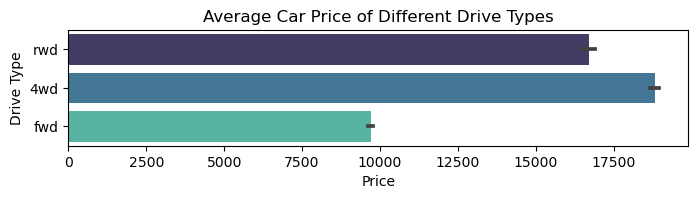

,price,cylinders,odometer,age,Ferrari,is_vintage
drive,,,,,,
fwd,9695.389366,4.694090,111538.744207,11.754885,0.000000,0.0
rwd,16697.389555,6.726434,112397.375429,13.374472,0.001013,0.0
4wd,18816.316953,6.275561,117262.063594,11.739204,0.000000,0.0


In [245]:
# plot the average price of different feature values
plot_data = df.query("is_vintage !=1")
feature = 'drive'
plt.figure(figsize=(8, 1.5))
sns.barplot(x='price', y=feature, data=plot_data, estimator=lambda x: sum(x) / len(x),palette ='mako')
plt.title('Average Car Price of Different Drive Types')
plt.xlabel('Price')
plt.ylabel('Drive Type')
plt.savefig(f'images/price_by_{feature}.png', bbox_inches='tight')
plt.show()

plot_data.groupby(feature).mean(numeric_only=True).sort_values('price')

### "One-standing" Encode the `drive` column
* Marginal mean price difference between `4wd` and `rwd`
* Create a new column, `is_fwd`, per its `drive`  values. If `drive` is 'fwd', set `is_fwd`=1, otherwise 0.

In [246]:
# Create a new column, `is_fwd`. Set value as 1 or 0 per its `drive` value
ed.one_standing_encode(column='drive', keep='fwd', name='is_fwd', drop=True)
# drop=True dropped the 'drive' column in-place

In [247]:
ed.column_null_stats()

,null count,pct_total,dtype
type,19113,15.05,object
transmission,3736,2.94,object


### The `transmission` column
* Marginal difference in mean prices between manual and automatic drives

In [248]:
df.dropna(subset=['transmission'], inplace=True)

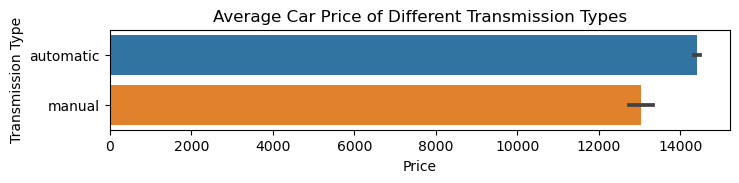

In [249]:
# plot the average price of different feature values
plot_data = df.query("is_vintage !=1")
feature = 'transmission'
plt.figure(figsize=(8, 1.3))
sns.barplot(x='price', y=feature, data=plot_data, estimator=lambda x: sum(x) / len(x))
plt.title('Average Car Price of Different Transmission Types')
plt.xlabel('Price')
plt.ylabel('Transmission Type')
plt.savefig(f'images/price_by_{feature}.png', bbox_inches='tight')
plt.show()

# plot_data.groupby(feature).mean(numeric_only=True).sort_values('price')

In [250]:
df.transmission.value_counts()

automatic    112897
manual        10342
Name: transmission, dtype: int64

In [251]:
ed.one_standing_encode(column='transmission', keep='manual', name='manual_shift', drop=False)

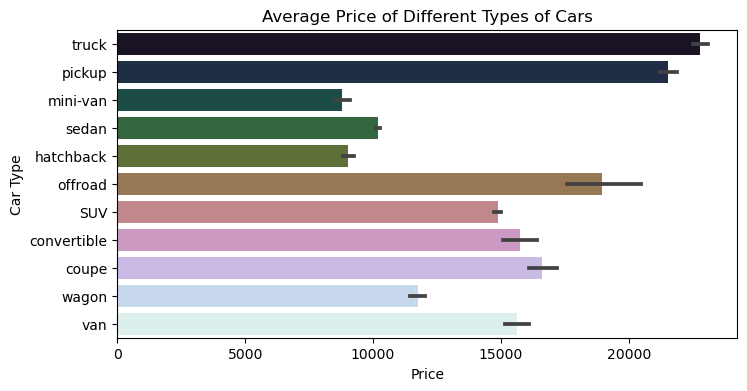

In [252]:
# plot the average price of different types of cars
plot_data = df.query("is_vintage !=1")
feature = 'type'
plt.figure(figsize=(8, 4))
sns.barplot(x='price', y=feature, data=plot_data, estimator=lambda x: sum(x) / len(x),palette='cubehelix')
plt.title('Average Price of Different Types of Cars')
plt.xlabel('Price')
plt.ylabel('Car Type')
plt.savefig(f"images/price_by_{feature}.png", bbox_inches='tight')
plt.show()

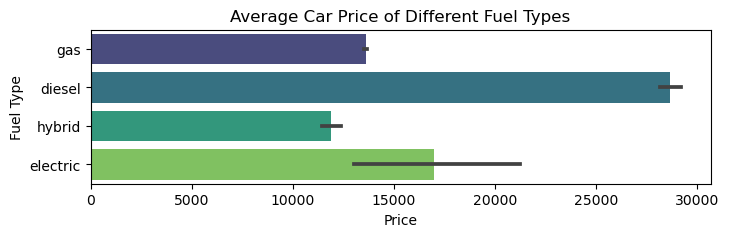

In [253]:
# plot the average price of different fuel types
plot_data = df.query("is_vintage !=1")
feature = 'fuel'
plt.figure(figsize=(8, 2))
sns.barplot(x='price', y=feature, data=plot_data, estimator=lambda x: sum(x) / len(x),palette='viridis')
plt.title('Average Car Price of Different Fuel Types')
plt.xlabel('Price')
plt.ylabel('Fuel Type')
plt.savefig(f'images/price_by_{feature}.png', bbox_inches='tight')
plt.show()

### One-hot Encode the  `type` and `fuel` columns

In [254]:
df.dropna(subset=['type', 'fuel'], inplace=True)
df = pd.get_dummies(df, columns=['type', 'fuel'], prefix='', prefix_sep='')

### The `odometer` Column
* Removal of Outliers in Odometer Readings: Any readings exceeding the threshold of the mean plus twice the standard deviation are excluded - greater than (mean + 2 * std)

In [255]:
df.drop(df.query("odometer < 1000 and price < 10000").index, inplace=True)

In [256]:
df.odometer.describe()

count    1.041340e+05
mean     1.183317e+05
std      1.955530e+05
min      0.000000e+00
25%      6.800000e+04
50%      1.098000e+05
75%      1.522555e+05
max      1.000000e+07
Name: odometer, dtype: float64

### The `manufacturer` Column

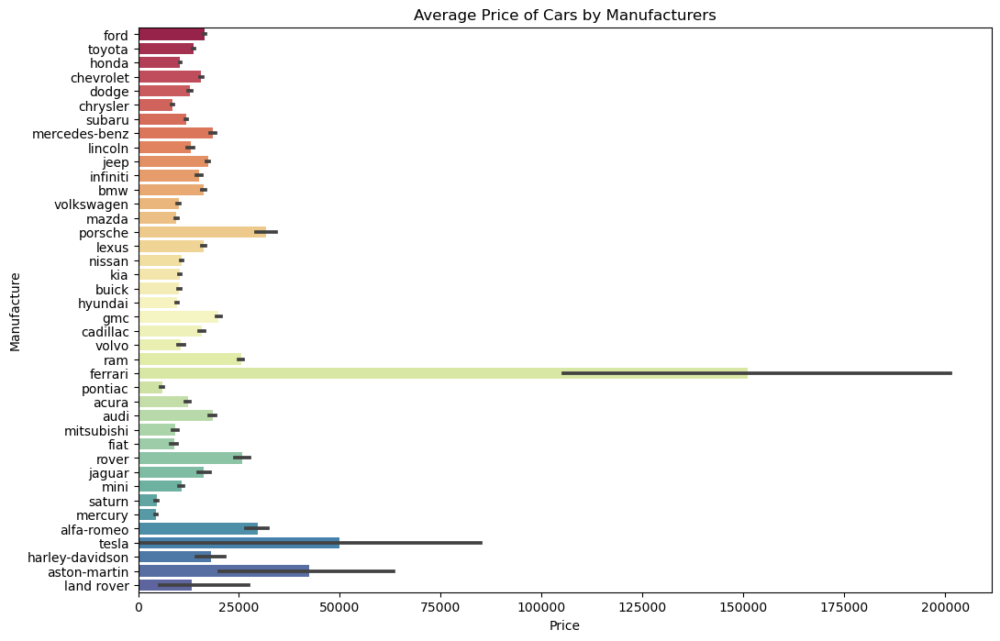

In [257]:

# plot the average price of different 
plot_data = df.query("age < 25")
feature = 'manufacturer'
plt.figure(figsize=(12, 8))
sns.barplot(x='price', y=feature, data=plot_data, estimator=lambda x: sum(x) / len(x) ,palette ='Spectral')
plt.title('Average Price of Cars by Manufacturers')
plt.xlabel('Price')
plt.ylabel('Manufacture')
plt.savefig(f"images/price_by_{feature}.png", bbox_inches='tight')
plt.show()


In [258]:
#Detection and Elimination of Various Data Inconsistencies and Anomalies

df.query("is_vintage !=1 and Ferrari ==0").price.describe()

count     96201.000000
mean      14536.280039
std       12238.421971
min         500.000000
25%        6000.000000
50%       10988.000000
75%       18995.000000
max      255000.000000
Name: price, dtype: float64

In [259]:
# Fence = mean + 3 * std
fence = df.query("is_vintage !=1").price.mean() + 3 * df.query("is_vintage !=1").price.std()
df.drop(df.query("price > @fence and is_vintage !=1 and Ferrari ==0").index, inplace=True)

In [260]:
df.drop(df.query("price < 3000").index, inplace=True)

In [261]:
df[ df.odometer/(df.age+1) > 50000]

,price,manufacturer,model,cylinders,odometer,title_status,transmission,age,Ferrari,is_vintage,...,offroad,pickup,sedan,truck,van,wagon,diesel,electric,gas,hybrid
562,27990,ram,2500 4x4,6.0,2222222.0,clean,automatic,9,0,0,...,0,0,0,1,0,0,1,0,0,0
616,17990,ford,edge sel,6.0,1111111.0,clean,automatic,5,0,0,...,0,0,0,0,0,0,0,0,1,0
8617,3795,subaru,forester,4.0,999999.0,clean,automatic,17,0,0,...,0,0,0,0,0,1,0,0,1,0
8851,3195,chevrolet,sonic,4.0,999999.0,clean,automatic,10,0,0,...,0,0,0,0,0,0,0,0,1,0
14045,3500,chevrolet,ck 2500,8.0,2076920.0,clean,automatic,25,0,1,...,0,1,0,0,0,0,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
394247,13900,ford,f-150,8.0,1464726.0,clean,automatic,14,0,0,...,0,0,0,1,0,0,0,0,1,0
398088,10800,ford,f100 ranger,8.0,9999999.0,clean,automatic,54,0,1,...,0,1,0,0,0,0,0,0,1,0
398447,6600,ford,fusion hybrid,4.0,1247413.0,clean,automatic,13,0,0,...,0,0,1,0,0,0,0,0,1,0
415173,28750,volvo,vnl64t300,6.0,586692.0,clean,manual,8,0,0,...,0,0,0,1,0,0,1,0,0,0


In [262]:
df.drop(df[ df.odometer/(df.age+1) > 50000].index, inplace=True)

###  Final Review to Identify and Address Any Remaining Missing Data

In [263]:
df.isna().sum()

price           0
manufacturer    0
model           0
cylinders       0
odometer        0
title_status    0
transmission    0
age             0
Ferrari         0
is_vintage      0
is_fwd          0
manual_shift    0
SUV             0
convertible     0
coupe           0
hatchback       0
mini-van        0
offroad         0
pickup          0
sedan           0
truck           0
van             0
wagon           0
diesel          0
electric        0
gas             0
hybrid          0
dtype: int64

In [264]:
df.shape

(94829, 27)

### Vintage / Non-vintage Split Segregation into Vintage and Non-Vintage Datasets

Henceforth, 'df' will represent the dataset containing non-vintage cars, while 'df_vintage' will be dedicated to vintage cars

In [265]:
# Keep ONLY numeric features
df = df.select_dtypes(include=np.number)
# Split by vintage or not
df, df_vintage = df[df['is_vintage'] == 0], df[df['is_vintage'] == 1]
df.drop(columns='is_vintage', inplace=True)
df_vintage.drop(columns='is_vintage', inplace=True)


## Correlations of Variables (Non-vintage cars)
Analysis of Variable Interrelationships in the Non-Vintage Car Dataset

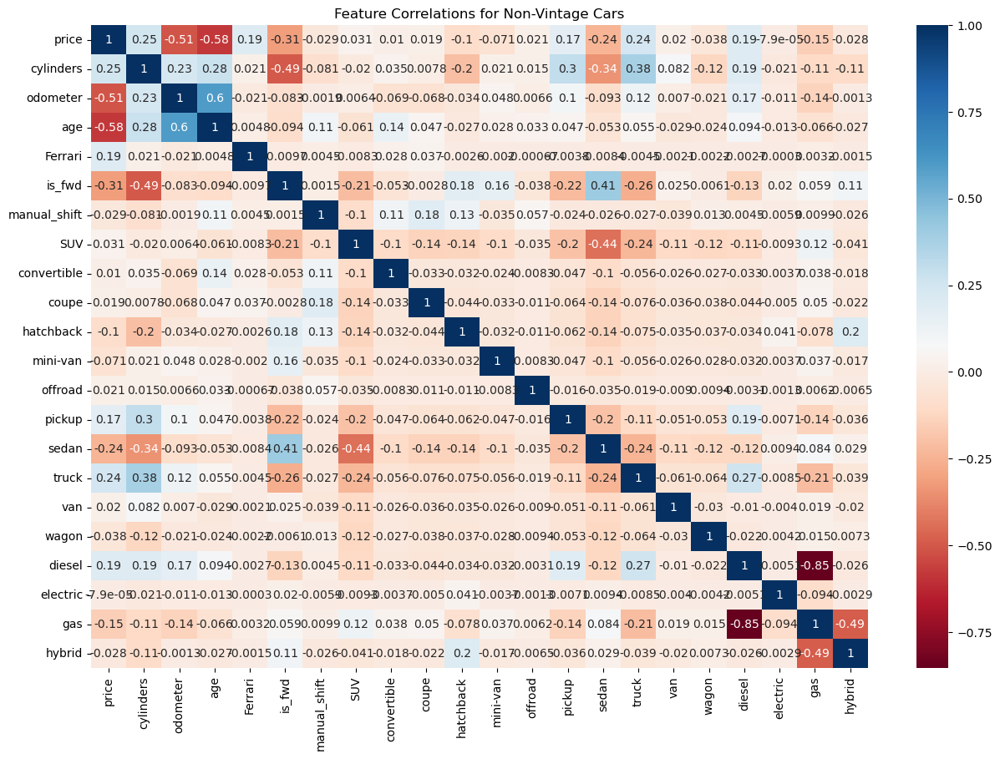

In [267]:
# Correlations for Non-vintage cars
plot_data = df
plt.figure(figsize=(15, 10))
plt.title("Feature Correlations for Non-Vintage Cars", loc='center')
sns.heatmap(plot_data.corr(numeric_only=True), annot=True, cmap='RdBu')
plt.savefig("images/heatmap_non_vintage.png", bbox_inches='tight')
plt.show()

### Variable Correlations (Vintage cars)
Examination of Interrelations Among Variables in the Vintage Car Dataset

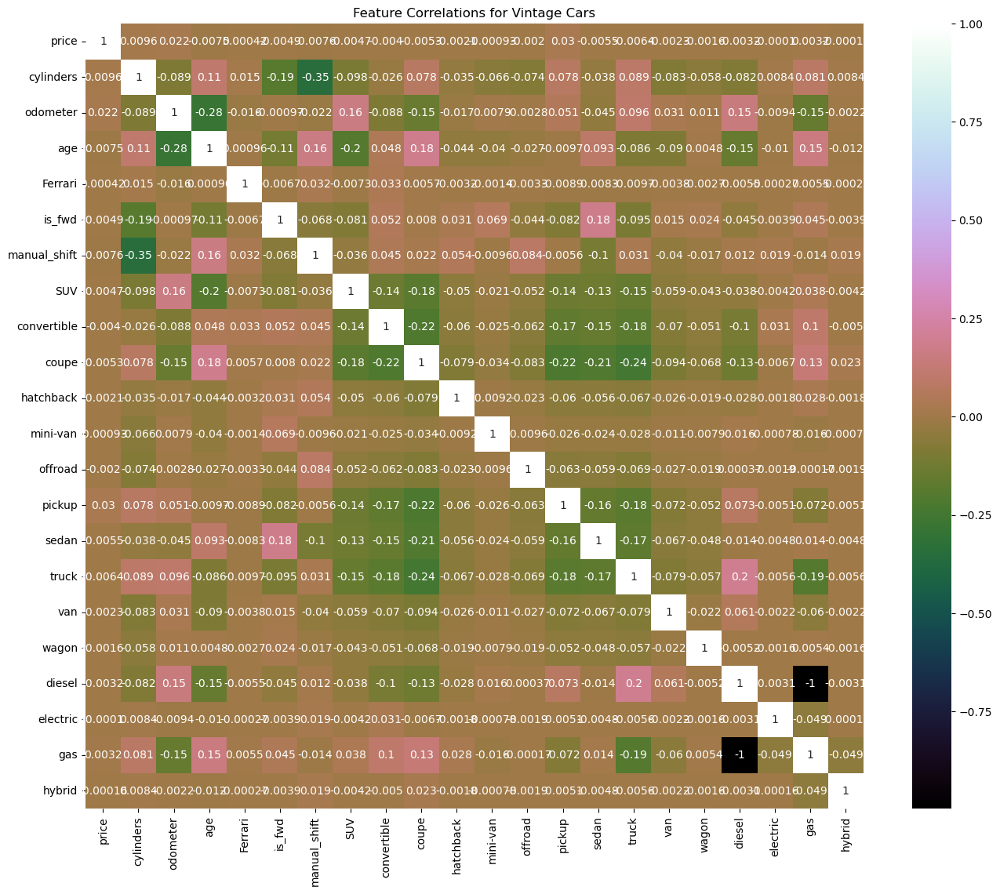

In [269]:
# Correlations for vintage cars
# Create the heatmap using Seaborn
plot_data = df_vintage
plt.figure(figsize=(16, 13))
plt.title("Feature Correlations for Vintage Cars", loc='center')
sns.heatmap(plot_data.corr(numeric_only=True), annot=True, cmap='cubehelix')
plt.savefig("images/heatmap_vintage.png", bbox_inches='tight')
plt.show()

##  Training and Testing Data Subsets Phase
* Establishment of Training and Testing Data Subsets

In [270]:
target = 'price'
X, y = df.drop(target, axis = 1), df[target]
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=.25, random_state = 42)


## Model Development Phase

### Pipeline and Grid Search Configuration
The objective of the GridSearchCV setup is to identify a model with the minimal Mean Absolute Percentage Error (MAPE). This is chosen over Mean Squared Error (MSE) or Root Mean Squared Error (RMSE) as a performance metric because MAPE accounts for relative errors. For instance, a prediction error of 3,000 on a car worth 300,000 (representing a 1 percent error) is viewed differently compared to the same 3,000 error on a car valued at $3,000 (constituting a 100 percent error), a distinction that MSE and RMSE do not make.

In [271]:
# Defiine the pipleline and GridSearchCV
pipeline = Pipeline(steps=[
    ('scaler', StandardScaler()),
    ('selector', SequentialFeatureSelector(estimator=Lasso(max_iter=10000))),
    ('regressor', LinearRegression()),
])
# This pipleline and GridSearchCV always picks the most n_features_to_select, and smallest aplha with intercept as the best model
hyper_params = {
    "selector__n_features_to_select": [6],
    "selector__estimator__alpha": [0.001],
    'regressor__fit_intercept': [True],
}
grid_search = GridSearchCV(pipeline, scoring='neg_mean_absolute_percentage_error', param_grid=hyper_params, cv=5)
grid_search

GridSearchCV(cv=5,
             estimator=Pipeline(steps=[('scaler', StandardScaler()),
                                       ('selector',
                                        SequentialFeatureSelector(estimator=Lasso(max_iter=10000))),
                                       ('regressor', LinearRegression())]),
             param_grid={'regressor__fit_intercept': [True],
                         'selector__estimator__alpha': [0.001],
                         'selector__n_features_to_select': [6]},
             scoring='neg_mean_absolute_percentage_error')

### Model Fitting Process Phase

In [272]:
import time
start_time = time.time()
grid_search.fit(X, y)
end_time = time.time() 
duration = end_time - start_time
print(f"Time taken for fitting: {duration / 60:.1f} minutes\n")

Time taken for fitting: 0.4 minutes




### Identification of the Optimal Model as Determined by GridSearchCV

In [273]:
# Best Model
best_estimator = grid_search.best_estimator_
regressor_step = best_estimator.named_steps['regressor']
# Retreive Selected Features and Coefficients
if isinstance(regressor_step, TransformedTargetRegressor):
    best_model = regressor_step.regressor_
else:
    best_model = best_estimator.named_steps['regressor']
print(f'Best Estimator: {best_estimator}\n')
print(f'Score: {grid_search.scoring} = {round(grid_search.best_score_, 4)}')

Best Estimator: Pipeline(steps=[('scaler', StandardScaler()),
                ('selector',
                 SequentialFeatureSelector(estimator=Lasso(alpha=0.001,
                                                           max_iter=10000),
                                           n_features_to_select=6)),
                ('regressor', LinearRegression())])

Score: neg_mean_absolute_percentage_error = -0.4191



### Analysis of Model Feature Coefficients and Intercept
* Examination of Model Coefficients and Intercept within StandardScaler Sp


Selected Features & Coefficients(in StandardScaler space)
('cylinders', 3401.0)
('odometer', -3293.07)
('age', -5320.82)
('Ferrari', 1857.44)
('is_fwd', -1999.13)
('diesel', 2114.42)
('intercept', 14536.67)


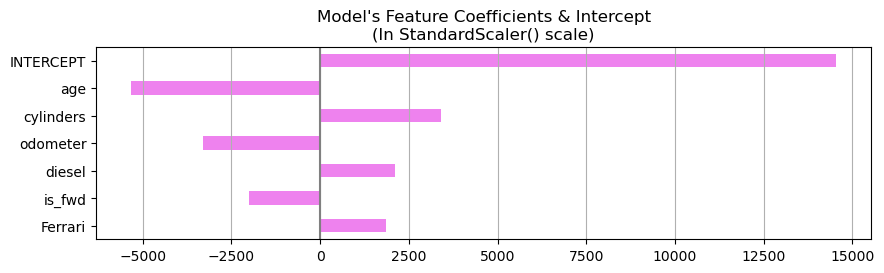

In [276]:
### Coeffiicnets & Intercept in StandardScalar Space

# Selected Features
selector = best_estimator.named_steps['selector']
selection_mask = selector.get_support()
selected_features = X.columns[selection_mask] # an index object

# Raw Intercept and Coefficients
intercept = best_model.intercept_
coefs = best_model.coef_

# Not Implemented
# Check if TransformedTargetRegressor is present in the pipeline.
# If it is, invert the raw coeffieients and intercept to origianl scale space
# if isinstance(regressor_step, TransformedTargetRegressor):
#     # Access the inverse_func from TransformedTargetRegressor
#     inverse_func = regressor_step.inverse_func
#     # Access the coefficients from the underlying regressor
#     transformed_coefs = best_model.coef_
#     coefs = inverse_func(transformed_coefs)
#     intercept = inverse_func(intercept)
    
# Output
rounded_coefs = [round(coef, 2) for coef in coefs]
feature_coef_tuples = list(zip(selected_features, rounded_coefs))
feature_coef_tuples.append(('intercept', round(intercept, 2)))
print("\nSelected Features & Coefficients(in StandardScaler space)")
for i in range(0, len(feature_coef_tuples)):
    print(feature_coef_tuples[i])
    

# Plotting the Selected Feature Weights in StandarScalar scaled space
plot_coefs = pd.DataFrame(coefs, index=selected_features, columns=['Coefficient'])
plot_coefs.loc['INTERCEPT'] = intercept
plot_coefs['abs'] = abs(plot_coefs['Coefficient'])
plot_coefs = plot_coefs.sort_values('abs', ascending=True)
plot_coefs['Coefficient'].plot(kind="barh", figsize=(10, len(selected_features)/2.4), color='violet')
plt.title("Model's Feature Coefficients & Intercept\n(In StandardScaler() scale)")
plt.axvline(x=0, color=".5")
# plt.subplots_adjust(left=0.3)
plt.grid(axis='x')
plt.savefig(f"images/scaled_{len(selected_features)}_feature_weights.png", bbox_inches='tight')




Selected Features & Coefficients (Original Scale)
('cylinders', 2154.38)
('odometer', -0.06)
('age', -1063.83)
('Ferrari', 147617.38)
('is_fwd', -4138.04)
('diesel', 10307.02)
('intercept', 22023.35)


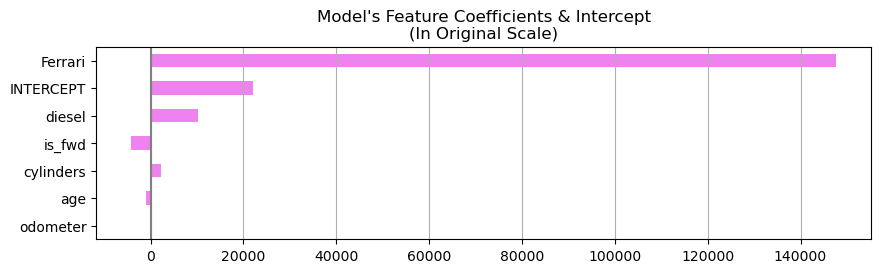

In [278]:
### Coeffiicnets & Intercept in Original Unscaled Space
# Unscale the coefficient and intercept
try:
    scaler = best_estimator.named_steps['scaler']
except:
    pass

if scaler:
    # Mask scaler's mean and scale to align with selected features' dimensions
    scaler_mean_masked = scaler.mean_[selection_mask]
    scaler_scale_masked = scaler.scale_[selection_mask]

    # Transform the coefficients to the original scale considering only selected features
    coefs_unscaled = coefs / scaler_scale_masked
    intercept_unscaled = intercept - sum(coefs_unscaled * scaler_mean_masked)

    # Output
    rounded_coefs_unscaled = [round(coef, 2) for coef in coefs_unscaled]
    feature_coef_tuples_unscaled = list(zip(selected_features, rounded_coefs_unscaled))
    feature_coef_tuples_unscaled.append(('intercept', round(intercept_unscaled, 2)))
    print("\nSelected Features & Coefficients (Original Scale)")
    for i in range(len(feature_coef_tuples_unscaled)):
        print(feature_coef_tuples_unscaled[i])    

    # Plotting the Selected Feature Weights in StandarScalar scaled space
    plot_coefs = pd.DataFrame(coefs_unscaled, index=selected_features, columns=['Coefficient'])
    plot_coefs.loc['INTERCEPT'] = intercept_unscaled
    plot_coefs['abs'] = abs(plot_coefs['Coefficient'])
    plot_coefs = plot_coefs.sort_values('abs', ascending=True)
    plot_coefs['Coefficient'].plot(kind="barh", figsize=(10, len(selected_features)/2.4), color='violet')
    plt.title("Model's Feature Coefficients & Intercept\n(In Original Scale)")
    plt.axvline(x=0, color=".5")
    # plt.subplots_adjust(left=0.3)
    plt.grid(axis='x')
    plt.savefig(f"images/original_{len(selected_features)}_feature_weights.png", bbox_inches='tight')



###  Comparison of Predicted Car Prices with Actual Market Values of Car

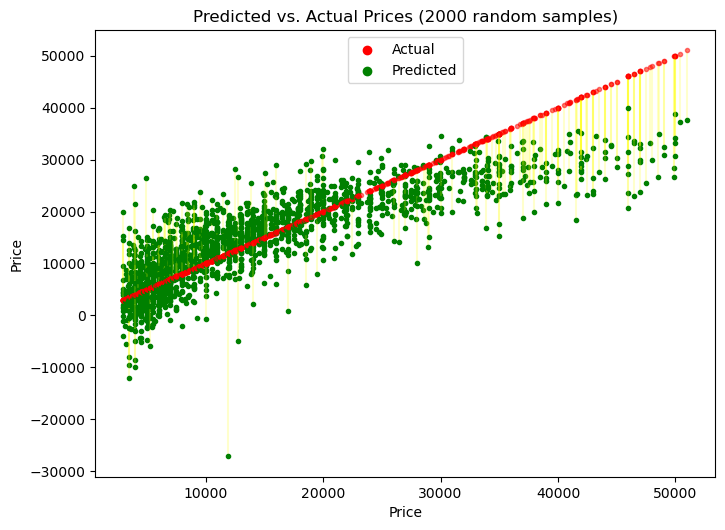

In [281]:
# Selected Model
model = best_estimator
# Preditions on the training set
train_preds = model.predict(X_train)
# Preditions on the testin set
test_preds = model.predict(X_test)

# Plot the Predicted vs. Actual Prices
full_data = pd.DataFrame({
    'Actual': y_test.values, # y_test is a Series
    'Predicted': pd.Series(test_preds).values # test_preds is a numpy.ndarray
})
vs_samples = min(2000, len(y_test))
vs_data = full_data.sample(vs_samples, random_state=42)

# Sort data by actual prices
vs_data = vs_data.sort_values(by='Actual')
max_price = 250000 # To exclude outliers that blow the scale of the plot

plt.figure(figsize=(8, 5.8))
act_color = 'red'
pred_color = 'green'
actual_handles = plt.scatter([], [], marker='o', color=act_color, label='Actual')
predicted_handles = plt.scatter([], [], marker='o', color=pred_color, label='Predicted')
# Plot candlestick for each sample
for _, row in vs_data.iterrows():
    if row['Actual'] < max_price: 
        if (row['Actual'] > 1000) & (abs(row['Actual'] - row['Predicted']) > 10000):
            # Plot vertical lines (candles)
            plt.plot([row['Actual'], row['Actual']], [row['Actual'], row['Predicted']], color='yellow', alpha=.2)

        # Plot markers for actual value
        plt.plot(row['Actual'], row['Actual'], marker='o', markersize=3, color=act_color, alpha=.5)

        # Plot markers for predicted value
        plt.plot(row['Actual'], row['Predicted'], marker='o', markersize=3, color=pred_color, alpha=1)

# Set labels and title
plt.xlabel('Price')
plt.ylabel('Price')
plt.title('Predicted vs. Actual Prices (' + str(vs_samples) + ' random samples)')

# Show legend for Actual and Predicted
plt.legend(handles=[actual_handles, predicted_handles], loc='upper center')
plt.grid(False)
plt.savefig(f"images/{len(selected_features)}_actual_vs_predicted.png", bbox_inches='tight')
plt.show()

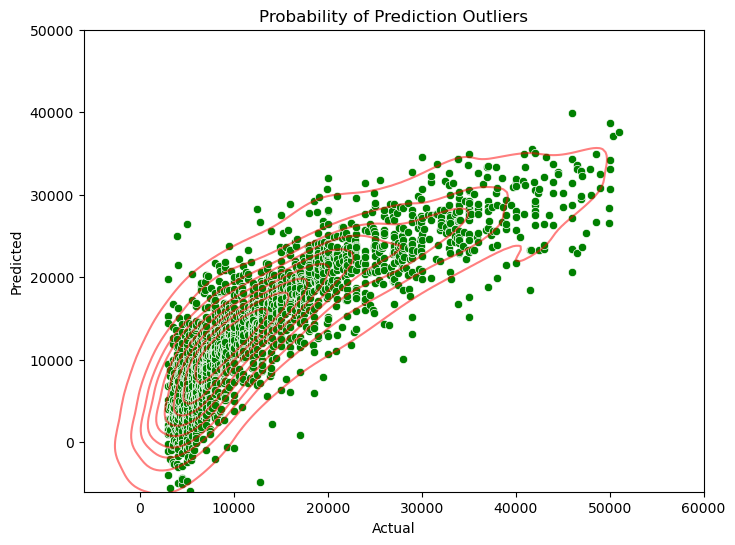

In [282]:
# Plot the Predicted vs Actual with KDE
x_values = vs_data['Actual']
y_values = vs_data['Predicted']
plt.figure(figsize=(8, 6))
sns.scatterplot(x=x_values, y=y_values, color=pred_color)
# Add KDE plot (Kernel Density Estimation)
sns.kdeplot(x=x_values, y=y_values, color='red', fill=False, alpha=.5)  
plt.title("Probability of Prediction Outliers")
plt.xlim(-6000, 60000)
plt.ylim(-6000, 50000)
plt.savefig(f"images/{len(selected_features)}_vs_kde_modified.png", bbox_inches='tight')
plt.show()

### Assessment of Model Performance: Investigating Causes of Negative Price Predictions

In [283]:
# Profiling cars with negtive predicted prices
negative_indices = test_preds < 0
# Use these indices to filter the rows in X_test where predictions are negative
X_test_negative_predictions = X_test[negative_indices]
X_test_negative_predictions.describe()

,cylinders,odometer,age,Ferrari,is_fwd,manual_shift,SUV,convertible,coupe,hatchback,...,offroad,pickup,sedan,truck,van,wagon,diesel,electric,gas,hybrid
count,691.000000,691.000000,691.000000,691.0,691.000000,691.000000,691.000000,691.000000,691.000000,691.000000,...,691.000000,691.000000,691.000000,691.000000,691.000000,691.000000,691.000000,691.000000,691.000000,691.000000
mean,4.748191,200223.156295,19.772793,0.0,0.714906,0.160637,0.215630,0.031838,0.076700,0.052098,...,0.007236,0.043415,0.426918,0.049204,0.023155,0.036179,0.005789,0.001447,0.971056,0.021708
std,1.140928,73933.147665,2.785919,0.0,0.451786,0.367462,0.411556,0.175696,0.266308,0.222386,...,0.084817,0.203938,0.494988,0.216450,0.150504,0.186872,0.075918,0.038042,0.167769,0.145833
min,3.000000,45500.000000,11.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,4.000000,156416.000000,18.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000
50%,4.000000,193000.000000,20.000000,0.0,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000
75%,6.000000,228916.000000,22.000000,0.0,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000
max,8.000000,999999.000000,24.000000,0.0,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


##Characteristics of Cars with Predicted Negative Prices:

The analysis reveals that on average, these vehicles are 20.1 years old, have odometer readings of 214,584 miles, and 70.9% are front-wheel drive.

These attributes align with the model's negative coefficients for these features, indicating a penalization by the model for these specific characteristics


### Assessment of Model Performance:  Performance Metrics

In [285]:
# Selected Model
# model = best_estimator
# train_preds = model.predict(X_train)
# test_preds = model.predict(X_test)

# Training set performance metrics
train_metrics = ed.performance_metrics(y_train, train_preds, len(selected_features))
# Testing set Performance metrics
test_metrics = ed.performance_metrics(y_test, test_preds, len(selected_features))
# Traing/Testing metrics
train_test_metrics = pd.concat([pd.DataFrame(train_metrics, index=['Training Set']),
                                pd.DataFrame(test_metrics, index=['Testing Set'])],
                                axis=0
                               )
print("Model Performance Metrics")
train_test_metrics

Model Performance Metrics


,R2,Adj. R2,MSE,RMSE,MAE,MAPE
Training Set,0.684137,0.684109,3.343284e+07,5782.113968,4279.599309,0.418274
Testing Set,0.683088,0.683002,3.225962e+07,5679.755104,4247.371784,0.414606


### Assessment of Model  Sensitivity- Sensitivity to In-feature Value Permutations
The feature permustion importance plot below indicates the model is stable under the in-feature value permutations.

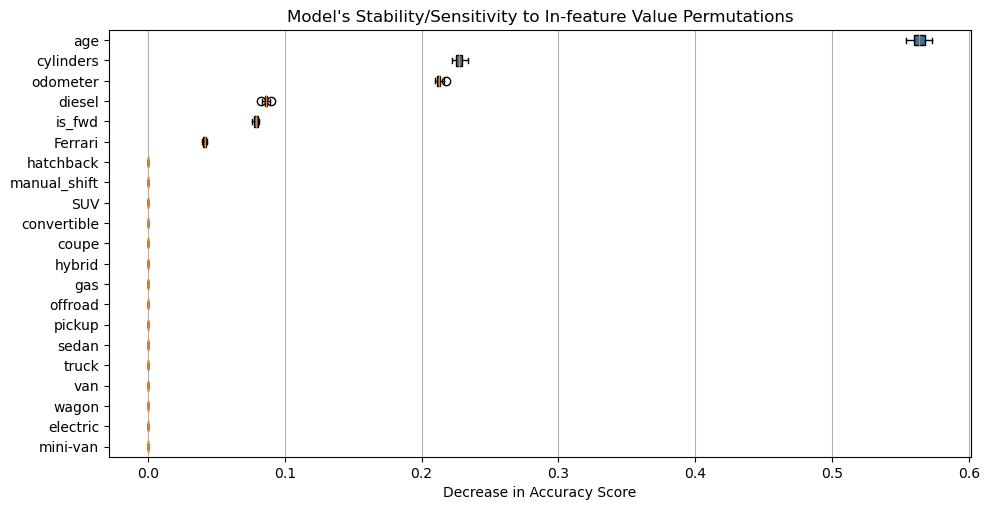

In [289]:
# Plot the Permutation Importance
def plot_permutation_importance(model, X, y, ax):
    result = permutation_importance(model, X, y, n_repeats=30, random_state=42, n_jobs=2)
    perm_sorted_idx = result.importances_mean.argsort()

    ax.boxplot(
        result.importances[perm_sorted_idx].T,
        vert=False,
        labels=X.columns[perm_sorted_idx],
        patch_artist=True
    )
    return ax
number_features = len(selected_features.tolist())
fig, (ax1) = plt.subplots(1, figsize=(10, 5))
plot_permutation_importance(model, X_test, y_test, ax1)
plt.xlabel("Decrease in Accuracy Score")
plt.tight_layout()
plt.grid(axis='x')
plt.title("Model's Stability/Sensitivity to In-feature Value Permutations")
plt.savefig(f"images/{len(selected_features)}_permutation_importance.png", bbox_inches='tight')

### Model Optimization Phase : Optimization of the Model with Non-Linear Adjustments

A refined approach to address predictions of negative or unreasonably low car prices involves implementing a modified, non-linear model with the following adjustment:

* For any car price predicted by the model to be below $500, the prediction is reset to $499.

 * This enhancement not only yields more realistic price predictions but also demonstrates significantly improved performance compared to the 'best model' as determined by GridSearchCV()."





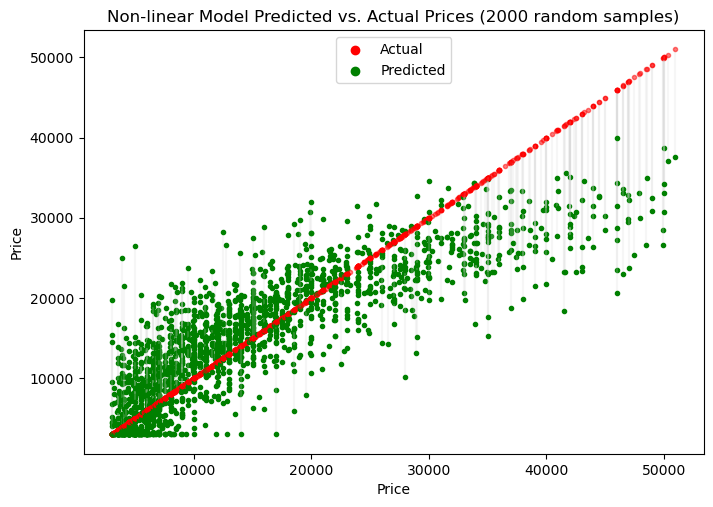

In [290]:
# Plot the modified non-leaner model on testing dataset and the modified predtions
modified_test_preds = np.where(test_preds < 3000, 2999, test_preds)
full_data = pd.DataFrame({
    'Actual': y_test.values,
    'Predicted': pd.Series(modified_test_preds).values
})
vs_samples = min(2000, len(y_test))
vs_data = full_data.sample(vs_samples, random_state=42)
# Sort data by actual prices
vs_data = vs_data.sort_values(by='Actual')

plt.figure(figsize=(8, 5.5))
act_color = 'red'
pred_color = 'green'
actual_handles = plt.scatter([], [], marker='o', color=act_color, label='Actual')
predicted_handles = plt.scatter([], [], marker='o', color=pred_color, label='Predicted')
# Plot candlestick for each sample
for _, row in vs_data.iterrows():
    if row['Actual'] < max_price: 
        if (row['Actual'] > 1000) & (abs(row['Actual'] - row['Predicted']) > 10000):
            # Plot vertical lines (candles)
            plt.plot([row['Actual'], row['Actual']], [row['Actual'], row['Predicted']], color='lightgray', alpha=.2)

        # Plot markers for actual value
        plt.plot(row['Actual'], row['Actual'], marker='o', markersize=3, color=act_color, alpha=.5)

        # Plot markers for predicted value
        plt.plot(row['Actual'], row['Predicted'], marker='o', markersize=3, color=pred_color, alpha=1)


# Set labels and title
plt.xlabel('Price')
plt.ylabel('Price')
plt.title('Non-linear Model Predicted vs. Actual Prices (' + str(vs_samples) + ' random samples)')

# Show legend for Actual and Predicted
plt.legend(handles=[actual_handles, predicted_handles], loc='upper center')
plt.grid(False)
plt.savefig(f"images/{len(selected_features)}_mod_actual_vs_predicted.png", bbox_inches='tight')
plt.show()

#### Visualization of Predicted Versus Actual Prices Using Kernel Density Estimation (KDE) Plot
* Plot Predicted vs. Actual with KDE

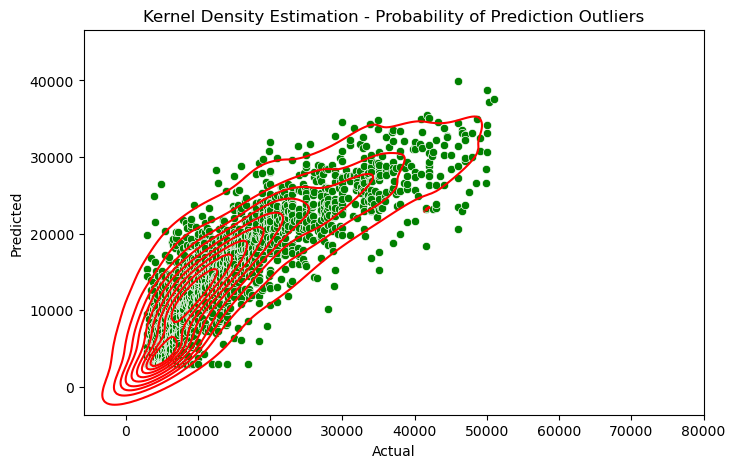

In [291]:
# Plot the Predicted vs Actual Prices
modified_vs_data = vs_data.query("Actual <80000")
x_values = modified_vs_data['Actual']
y_values = modified_vs_data['Predicted']
pred_color = 'green'
kde_color = 'red'
plt.figure(figsize=(8, 5))
sns.scatterplot(x=x_values, y=y_values, color=pred_color)
# Add KDE plot
sns.kdeplot(x=x_values, y=y_values, color=kde_color, fill=False, alpha=1)  
plt.title("Kernel Density Estimation - Probability of Prediction Outliers")
plt.xticks(range(0, 80100, 10000))
plt.savefig(f"images/{len(selected_features)}_vs_kde_modified.png", bbox_inches='tight')
plt.show()

### Visualization of Percentage Errors
*  Notably, higher percentage errors are observed in cars with lower values.

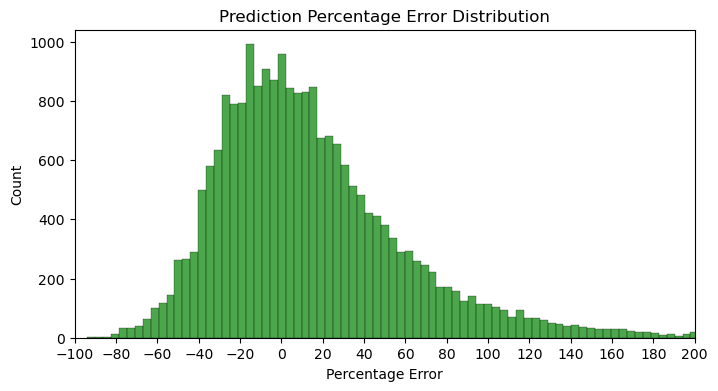

In [292]:
# Plot percentage errors
percentage_errors = (full_data['Predicted'] - full_data['Actual']) / full_data['Actual'] * 100

plot_data = pd.DataFrame({
    'Percentage Error': percentage_errors
})
plt.figure(figsize=(8, 4))
sns.histplot(plot_data, x='Percentage Error', color=pred_color, alpha=.7)
# Set x-axis limits to show only errors up to 100%
plt.xlim(-100, 200)
plt.xticks(range(-100, 201, 20))
plt.title("Prediction Percentage Error Distribution")
plt.savefig(f"images/{len(selected_features)}_pct_error_hist.png", bbox_inches='tight')

In [294]:
modified_metrics = ed.performance_metrics(y_test, modified_test_preds, len(selected_features))
modified_test_metrics = pd.concat([pd.DataFrame(test_metrics, index=['Original']),
                                   pd.DataFrame(modified_metrics, index=['Enhanced'])],
                                  axis=0
                               )
print(f"{len(selected_features)}-Feature Model Performance Metrics")
print(modified_test_metrics)

6-Feature Model Performance Metrics
                R2   Adj. R2           MSE         RMSE          MAE      MAPE
Original  0.683088  0.683002  3.225962e+07  5679.755104  4247.371784  0.414606
Enhanced  0.707042  0.706963  2.982121e+07  5460.879615  4005.655742  0.360107


In [299]:
modified_metrics = ed.performance_metrics(y_test, modified_test_preds, len(selected_features))
modified_test_metrics = pd.concat([pd.DataFrame(test_metrics, index=['Original']),
                                   pd.DataFrame(modified_metrics, index=['Enhanced'])],
                                  axis=0
                               )
print(f"{len(selected_features)}-Feature Model Performance Metrics")
print(modified_test_metrics)

6-Feature Model Performance Metrics
                R2   Adj. R2           MSE         RMSE          MAE      MAPE
Original  0.683088  0.683002  3.225962e+07  5679.755104  4247.371784  0.414606
Enhanced  0.707042  0.706963  2.982121e+07  5460.879615  4005.655742  0.360107


The quality of the dataset is a concern. Despite extensive data cleaning efforts, further refinement is necessary for more effective model development and prediction accuracy.

Exploring additional models or techniques, like PolynomialFeatureSelector or TransformedTargetRegressor, could lead to improvements in the predictive model.

Separate and specialized analysis for classic, vintage, and antique car sales is recommended, acknowledging their unique market dynamics and value determinants.

The project currently does not analyze vintage and antique cars. It's anticipated that these categories of cars require a distinct model for more accurate valuation, particularly due to their rarity. The impact of scarcity on antique car prices is significant, yet such data is not present in the dataset. In the absence of explicit scarcity information, an alternative approach might involve using the inverse of the age's quadratic or cubic term as a proxy.